# Image Blurring & Smoothing

In [2]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [31]:
# Utils
IMAGE_PATH = '../assets/bricks.jpg'

def load_img():
    img = cv.imread(IMAGE_PATH).astype(np.float32) / 255
    img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    return img

def show_img(img, cmap="jet"):
    fig = plt.figure(figsize=(15,15))
    subplot = fig.add_subplot(111)
    subplot.imshow(img, cmap=cmap)

def load_img_w_text():
    img = load_img()
    font = cv.FONT_HERSHEY_COMPLEX
    text = "BRICKS"
    cv.putText(img, text, (10,600), font, fontScale=10, color=(1,1,1), thickness=4)
    return img

## Gamma Correction

### Light

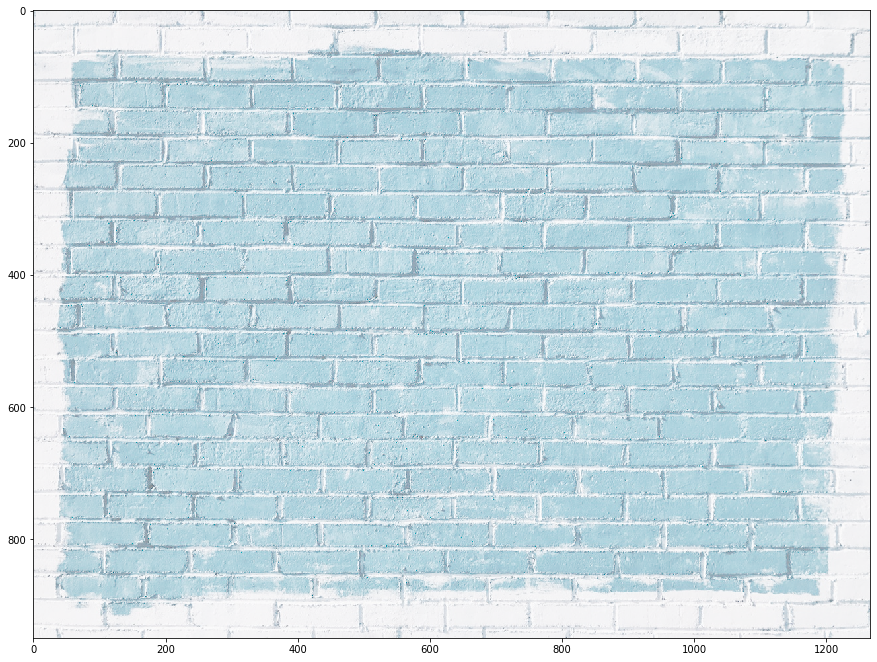

In [24]:
gamma = 1/4
img = np.power(load_img(), gamma);
show_img(img)

### Dark

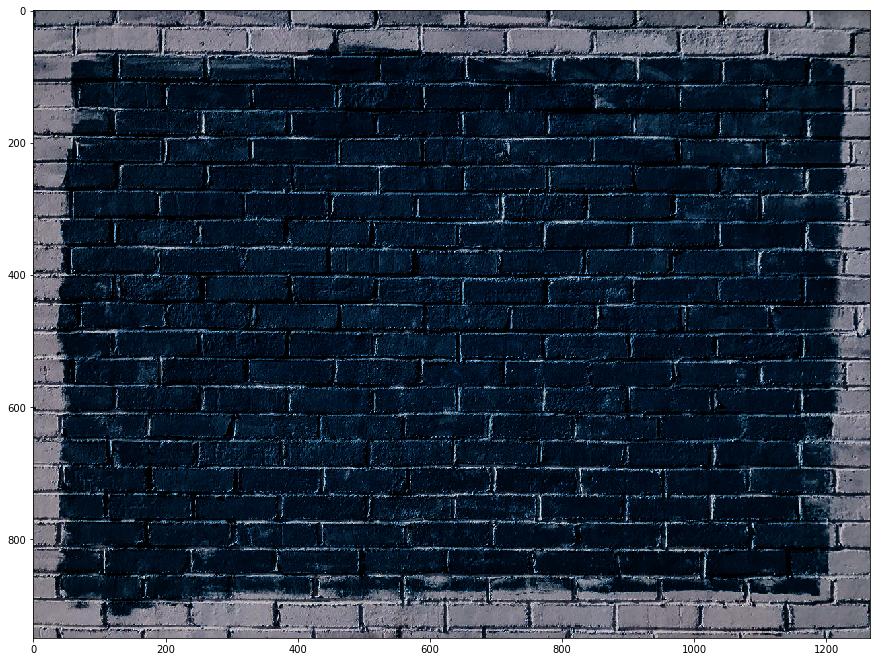

In [26]:
gamma = 4
img = np.power(load_img(), gamma);
show_img(img)

## Kernel Based Filters

#### Original Image

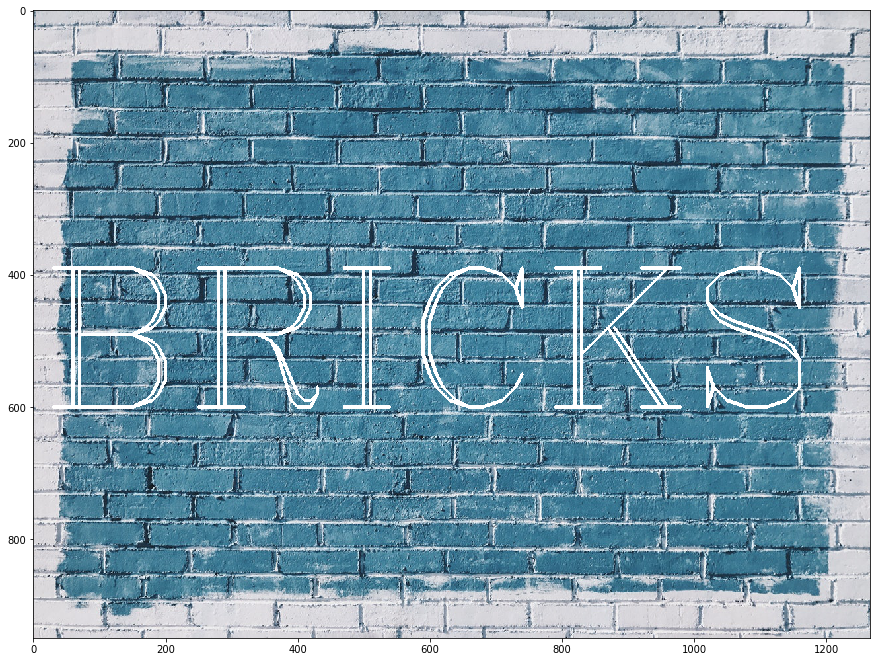

In [35]:
show_img(load_img_w_text())

#### Custom Kernel

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


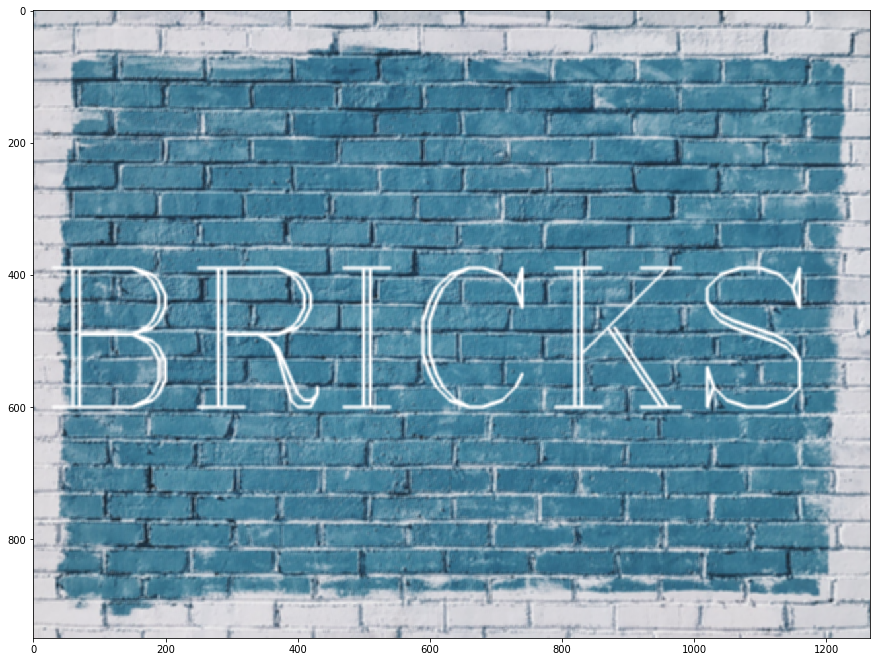

In [43]:
kernel = np.ones(shape=(5,5), dtype=np.float32) / 25
blurred_img = cv.filter2D(load_img_w_text(), -1, kernel)
show_img(blurred_img)

#### CV Blur Kernel

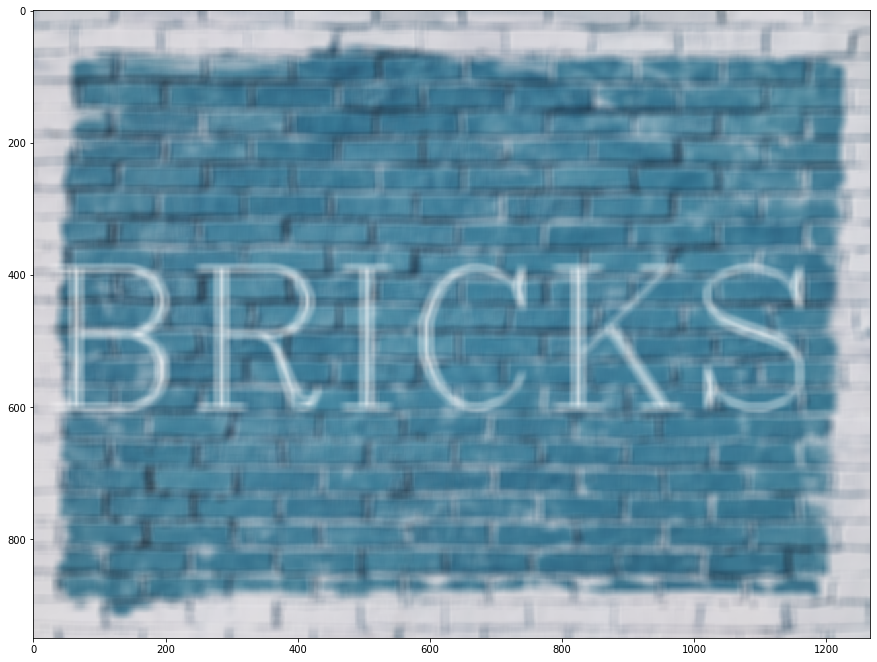

In [41]:
blurred_img = cv.blur(load_img_w_text(), ksize=(15,15))
show_img(blurred_img)

#### CV Gaussian Bluer Kernel

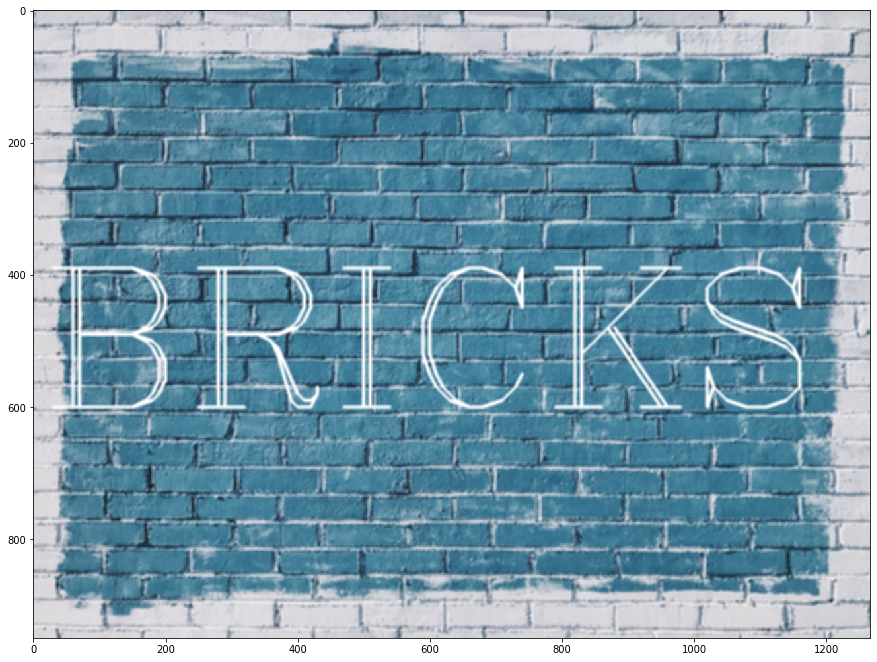

In [63]:
blurred_img = cv.GaussianBlur(load_img_w_text(), ksize=(5,5), sigmaX=10)
show_img(blurred_img)

#### Median Blur Kernel

__Obs:__ Nice for removing image noise w/out losing much quality

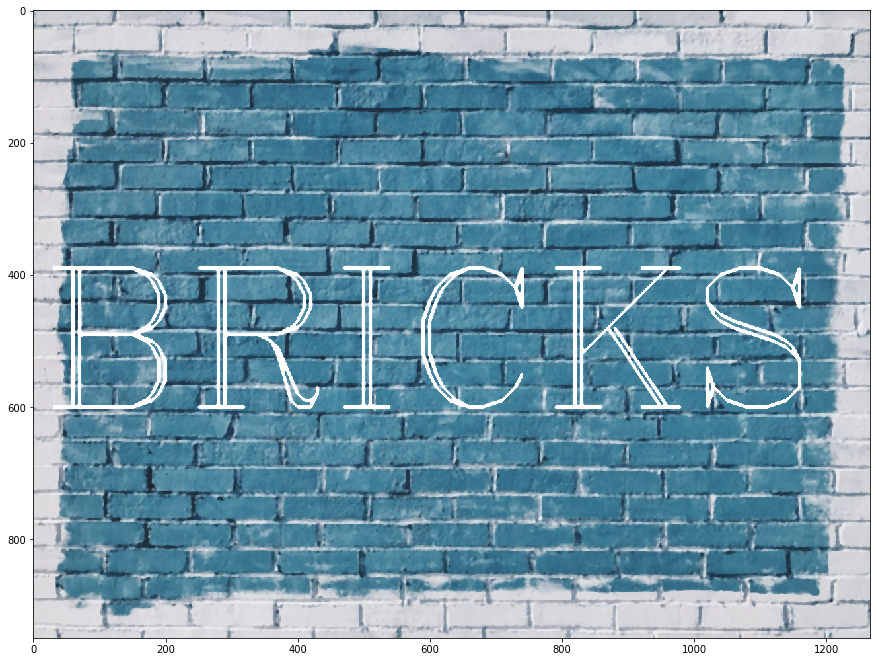

In [62]:
blurred_img = cv.medianBlur(load_img_w_text(), ksize=5)
show_img(blurred_img)

### Example

#### Original image

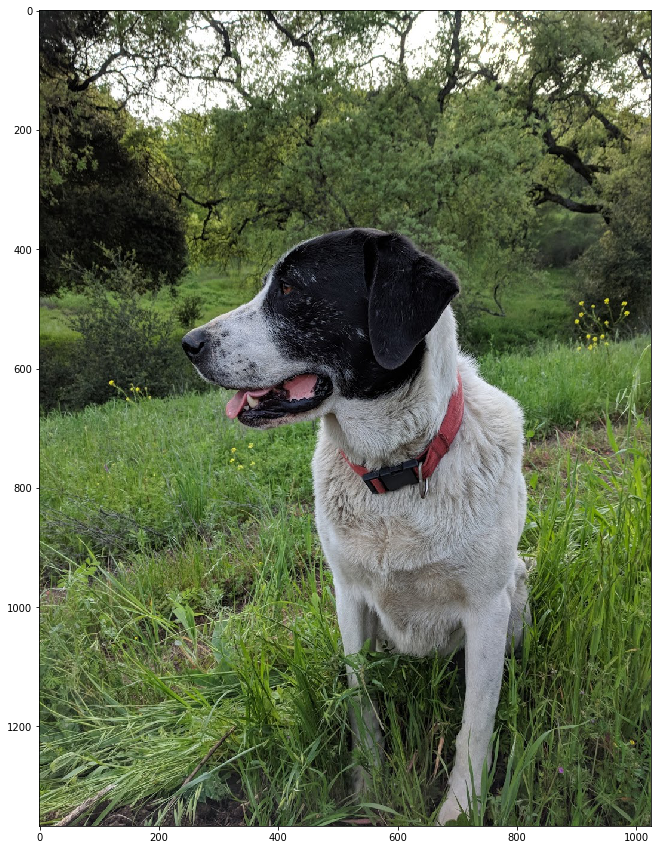

In [74]:
img = cv.imread("../assets/sammy.jpg")
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
show_img(img)

#### Noisy image

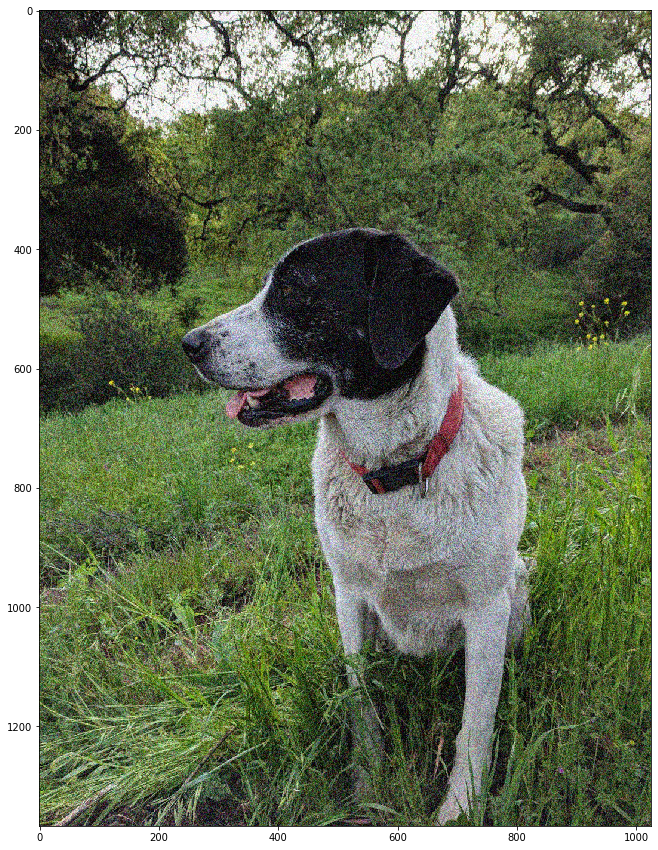

In [68]:
noise_img = cv.imread("../assets/sammy_noise.jpg")
show_img(noise_img)

#### "Fixed" image w/ blur

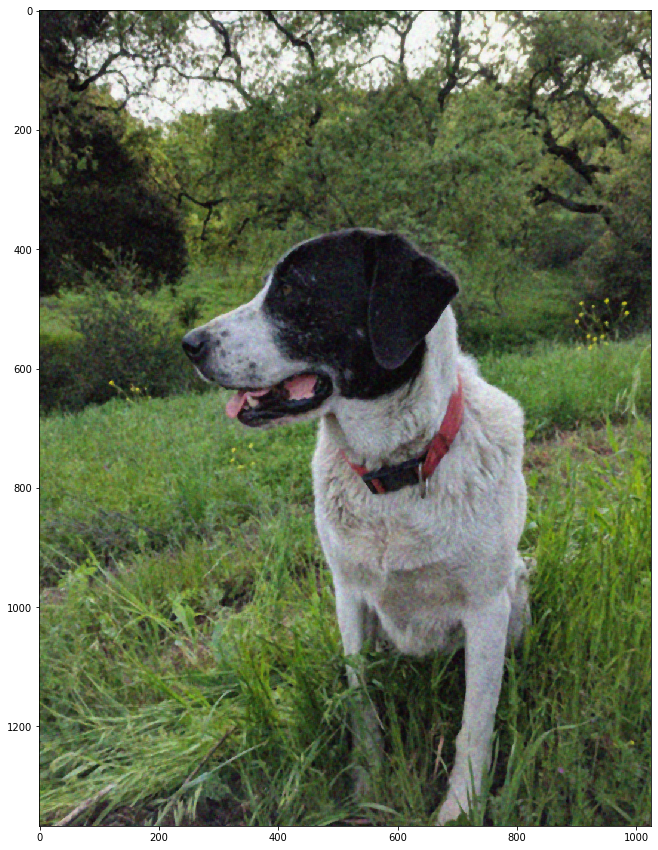

In [73]:
blurred_img = cv.medianBlur(noise_img, ksize=5)
show_img(blurred_img)